# **Checklist**

o que falta fazer: 

- construir gráficos para a análise desses dados
- ver se precisa tirar algum outlier (dados discrepantes ou inconsistentes) -> *acho que não precisa pq o outlier que tem é justamente no preço e nós não vamos usar essa coluna*
- transformação dos dados usando algum encoder (transformar categóricos em numéricos)
- dividir em treino e teste (em porcentagem, ex: 20 pra teste e 80 pra treino)
- previsão do preço
- regressão linear
- gráficos sobre os ultimos 2
- finalizar com comentários

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pandas as pd
import csv
import plotly.express as px

In [ ]:
df = pd.read_csv("/content/AB_NYC_2019.csv")
df

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2


In [ ]:
df.sample(2)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
39789,30938769,Bright 1 Bedroom / Columbia & Morningside Heights,88774551,Megan,Manhattan,Morningside Heights,40.81325,-73.96122,Entire home/apt,80,3,1,2018-12-20,0.15,1,0
5997,4392066,one room bushwick,5605897,Sarah,Brooklyn,Williamsburg,40.70903,-73.93940,Private room,100,1,0,NaN,NaN,1,0


In [ ]:
df.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object

In [ ]:
df.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

# Parte 1

**iremos fazer a previsão do preço a partir dos restantes dos dados**

previsão: price

colunas de base: 
  - neighbourhood_group, room_type,neighbourhood *(categoricos)*
  - minimum_nights, number_of_reviews, reviews_per_month, availability_365, latitude, longitude  *(numéricos)*


  os dados categóricos teremos que transformar para numéricos
  não sei se todas essas colunas vão ser relevantes..falta analisar isso

# --- Preparação do Dataset ---

Vamos fazer uma limitação do dataset por conta de problemas encontrados enquanto fazíamos o homework, dessa forma, vamos limitar os dados por meio da data

In [ ]:
filtro = (df['last_review'] >= '2019-01-01') & (df['last_review'] <= '2019-06-01')
df_filtro_2019 = df[filtro]

df_filtro_2019.reset_index(drop = True)
df_filtro_2019

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
22,8025,CBG Helps Haiti Room#2.5,22486,Lisel,Brooklyn,Park Slope,40.67989,-73.97798,Private room,80,1,39,2019-01-01,0.37,6,364
29,9657,Modern 1 BR / NYC / EAST VILLAGE,21904,Dana,Manhattan,East Village,40.72920,-73.98542,Entire home/apt,180,14,29,2019-04-19,0.24,1,67
30,9668,front room/double bed,32294,Ssameer Or Trip,Manhattan,Harlem,40.82245,-73.95104,Private room,50,3,242,2019-06-01,2.04,3,355
34,10452,Large B&B Style rooms,35935,Angela,Brooklyn,Bedford-Stuyvesant,40.68310,-73.95473,Private room,70,1,74,2019-05-12,0.66,2,269
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45983,35013529,Cozy Room 4 Min Walk From Train,236853675,Jojo,Brooklyn,Crown Heights,40.67145,-73.93355,Private room,38,1,1,2019-05-28,0.70,1,88
46027,35035847,TimeSquare High-level modern apartment 1BDR!,42174219,Zack,Manhattan,Theater District,40.76113,-73.98557,Private room,180,2,1,2019-06-01,0.77,1,31
46092,35069416,005 Comfy and Pleasant Shared Room,137999892,Simranjeet,Staten Island,Concord,40.60625,-74.08900,Shared room,30,4,1,2019-06-01,0.77,7,68
46113,35085802,Huge bedroom with private access to backyard.,201987117,Gershon,Queens,Ridgewood,40.70629,-73.91281,Private room,70,1,1,2019-05-27,0.68,1,0


Melhorando o skewness do price

In [ ]:
df['price_log'] = np.log(df.price+1)

Separando as colunas que iremos usar

In [ ]:
# tirando colunas que nao serão usadas
df = df.drop(columns=['name','id' ,'host_id','host_name','last_review','price'])
df

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price_log
0,Brooklyn,Kensington,40.64749,-73.97237,Private room,1,9,0.21,6,365,5.010635
1,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,1,45,0.38,2,355,5.420535
2,Manhattan,Harlem,40.80902,-73.94190,Private room,3,0,NaN,1,365,5.017280
3,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,1,270,4.64,1,194,4.499810
4,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,10,9,0.10,1,0,4.394449
...,...,...,...,...,...,...,...,...,...,...,...
48890,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,2,0,NaN,2,9,4.262680
48891,Brooklyn,Bushwick,40.70184,-73.93317,Private room,4,0,NaN,2,36,3.713572
48892,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,10,0,NaN,1,27,4.753590
48893,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,1,0,NaN,6,2,4.025352


# --- Transformação dos Dados (novo) ---

Retirando os nan 

In [ ]:
mean = df['reviews_per_month'].mean()
df['reviews_per_month'].fillna(mean, inplace=True)

In [ ]:
df

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price_log
0,Brooklyn,Kensington,40.64749,-73.97237,Private room,1,9,0.210000,6,365,5.010635
1,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,1,45,0.380000,2,355,5.420535
2,Manhattan,Harlem,40.80902,-73.94190,Private room,3,0,1.373221,1,365,5.017280
3,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,1,270,4.640000,1,194,4.499810
4,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,10,9,0.100000,1,0,4.394449
...,...,...,...,...,...,...,...,...,...,...,...
48890,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,2,0,1.373221,2,9,4.262680
48891,Brooklyn,Bushwick,40.70184,-73.93317,Private room,4,0,1.373221,2,36,3.713572
48892,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,10,0,1.373221,1,27,4.753590
48893,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,1,0,1.373221,6,2,4.025352


In [ ]:
X_df = df.iloc[:,:-1].values
X_df

array([['Brooklyn', 'Kensington', 40.647490000000005, ..., 0.21, 6, 365],
       ['Manhattan', 'Midtown', 40.75362, ..., 0.38, 2, 355],
       ['Manhattan', 'Harlem', 40.809020000000004, ...,
        1.3732214298586884, 1, 365],
       ...,
       ['Manhattan', 'Harlem', 40.81475, ..., 1.3732214298586884, 1, 27],
       ['Manhattan', "Hell's Kitchen", 40.757509999999996, ...,
        1.3732214298586884, 6, 2],
       ['Manhattan', "Hell's Kitchen", 40.76404, ..., 1.3732214298586884,
        1, 23]], dtype=object)

In [ ]:
y_df = df.iloc[:,-1].values
y_df

array([5.01063529, 5.420535  , 5.01727984, ..., 4.75359019, 4.02535169,
       4.51085951])

In [ ]:
from sklearn.preprocessing import LabelEncoder
X_neighbourhood_group = LabelEncoder()
X_neighbourhood = LabelEncoder()
X_room_type = LabelEncoder()

In [ ]:
X_df[:, 0] = X_neighbourhood_group.fit_transform(X_df[:, 0])
X_df[:, 1] = X_neighbourhood.fit_transform(X_df[:, 1])
X_df[:, 4] = X_room_type.fit_transform(X_df[:, 4])


In [ ]:
X_df

array([[1, 108, 40.647490000000005, ..., 0.21, 6, 365],
       [2, 127, 40.75362, ..., 0.38, 2, 355],
       [2, 94, 40.809020000000004, ..., 1.3732214298586884, 1, 365],
       ...,
       [2, 94, 40.81475, ..., 1.3732214298586884, 1, 27],
       [2, 95, 40.757509999999996, ..., 1.3732214298586884, 6, 2],
       [2, 95, 40.76404, ..., 1.3732214298586884, 1, 23]], dtype=object)

In [ ]:
column_names = ['neighbourhood_group',	'neighbourhood','latitude',	'longitude',	'room_type',	'minimum_nights',	'number_of_reviews',	'reviews_per_month',	'calculated_host_listings_count',	'availability_365']
df_airbnb = pd.DataFrame(X_df, columns = column_names)

In [ ]:
df_airbnb

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,1,108,40.6475,-73.9724,1,1,9,0.21,6,365
1,2,127,40.7536,-73.9838,0,1,45,0.38,2,355
2,2,94,40.809,-73.9419,1,3,0,1.37322,1,365
3,1,41,40.6851,-73.9598,0,1,270,4.64,1,194
4,2,61,40.7985,-73.944,0,10,9,0.1,1,0
...,...,...,...,...,...,...,...,...,...,...
48890,1,13,40.6785,-73.95,1,2,0,1.37322,2,9
48891,1,28,40.7018,-73.9332,1,4,0,1.37322,2,36
48892,2,94,40.8147,-73.9487,0,10,0,1.37322,1,27
48893,2,95,40.7575,-73.9911,2,1,0,1.37322,6,2


In [ ]:
#padronizando os dados

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df_airbnb = scaler.fit_transform(df_airbnb)

In [ ]:
df_airbnb

array([[-9.17827580e-01,  1.27616682e-02, -1.49384920e+00, ...,
        -7.76640978e-01, -3.47164266e-02,  1.91625031e+00],
       [ 4.41222101e-01,  2.89155885e-01,  4.52436023e-01, ...,
        -6.63138112e-01, -1.56104443e-01,  1.84027456e+00],
       [ 4.41222101e-01, -1.90897229e-01,  1.46839948e+00, ...,
         1.40838612e-14, -1.86451447e-01,  1.91625031e+00],
       ...,
       [ 4.41222101e-01, -1.90897229e-01,  1.57348017e+00, ...,
         1.40838612e-14, -1.86451447e-01, -6.51730078e-01],
       [ 4.41222101e-01, -1.76350165e-01,  5.23773529e-01, ...,
         1.40838612e-14, -3.47164266e-02, -8.41669456e-01],
       [ 4.41222101e-01, -1.76350165e-01,  6.43525178e-01, ...,
         1.40838612e-14, -1.86451447e-01, -6.82120378e-01]])

In [ ]:
column_names = ['neighbourhood_group',	'neighbourhood','latitude',	'longitude',	'room_type',	'minimum_nights',	'number_of_reviews',	'reviews_per_month',	'calculated_host_listings_count',	'availability_365']
df_airbnb = pd.DataFrame(df_airbnb, columns = column_names)

In [ ]:
df_airbnb

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,-0.917828,0.012762,-1.493849,-0.437652,0.909359,-0.293996,-0.320414,-7.766410e-01,-0.034716,1.916250
1,0.441222,0.289156,0.452436,-0.684639,-0.924247,-0.293996,0.487665,-6.631381e-01,-0.156104,1.840275
2,0.441222,-0.190897,1.468399,0.222497,0.909359,-0.196484,-0.522433,1.408386e-14,-0.186451,1.916250
3,-0.917828,-0.961892,-0.803398,-0.164450,-0.924247,-0.293996,5.538156,2.181110e+00,-0.186451,0.617065
4,0.441222,-0.670950,1.275660,0.177216,-0.924247,0.144807,-0.320414,-8.500840e-01,-0.186451,-0.856865
...,...,...,...,...,...,...,...,...,...,...
48890,-0.917828,-1.369209,-0.924616,0.048089,0.909359,-0.245240,-0.522433,1.408386e-14,-0.156104,-0.788486
48891,-0.917828,-1.151003,-0.497141,0.411637,0.909359,-0.147729,-0.522433,1.408386e-14,-0.156104,-0.583352
48892,0.441222,-0.190897,1.573480,0.075821,-0.924247,0.144807,-0.522433,1.408386e-14,-0.186451,-0.651730
48893,0.441222,-0.176350,0.523774,-0.843881,2.742965,-0.293996,-0.522433,1.408386e-14,-0.034716,-0.841669


*texto em itálico*# --- Data Analysis --- 

1. Define the goal of your goal and identify the output Y of your predictive model.
Describe your data and their features in terms of number of observations N, number
of predictor variables D. Make sure that predictors are numerical, not categorical.

**R:**

Objetivo: prever o preço a partir das outras colunas do nosso dataset;

Descrição: São 48895 análises (antes da limpeza dos dados), iremos utilizar a coluna price para as previsões e as colunas neighbourhood_group, neighbourhood room_type (categoricos) e minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, availability_365 (numéricos), as quais iremos utilizar a transformação para categóricos virarem numéricos, totalizando 8 colunas de previsores.

2. Perform a mono-variate analysis of each of the D predictors. Specifically, you must
plot their histogram, calculate their mean µd, standard deviation σd and skewness γd,
with d = 1, . . . , D, using all the N observations

**R:**

Achando o mean e o deviation>

In [ ]:
df.describe()

,latitude,longitude,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price_log
count,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000
mean,40.728949,-73.952170,7.029962,23.274466,1.373221,7.143982,112.781327,4.736885
std,0.054530,0.046157,20.510550,44.550582,1.497775,32.952519,131.622289,0.695344
min,40.499790,-74.244420,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000
25%,40.690100,-73.983070,1.000000,1.000000,0.280000,1.000000,0.000000,4.248495
50%,40.723070,-73.955680,3.000000,5.000000,1.220000,1.000000,45.000000,4.672829
75%,40.763115,-73.936275,5.000000,24.000000,1.580000,2.000000,227.000000,5.170484
max,40.913060,-73.712990,1250.000000,629.000000,58.500000,327.000000,365.000000,9.210440


In [ ]:
df_airbnb.describe()

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,4.889500e+04,4.889500e+04,4.889500e+04,4.889500e+04,4.889500e+04,4.889500e+04,4.889500e+04,4.889500e+04
mean,-8.991399e-15,5.305490e-16,3.949141e-14,1.662286e-13,7.635292e-15,-7.665145e-16,-2.315687e-14,-3.349251e-15,3.545441e-14,1.387977e-14
std,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00
min,-2.276877e+00,-1.558321e+00,-4.202474e+00,-6.331760e+00,-9.242470e-01,-2.939962e-01,-5.224332e-01,-9.101738e-01,-1.864514e-01,-8.568646e-01
25%,-9.178276e-01,-8.164210e-01,-7.124376e-01,-6.694733e-01,-9.242470e-01,-2.939962e-01,-4.999866e-01,-7.299045e-01,-1.864514e-01,-8.568646e-01
50%,4.412221e-01,-1.908972e-01,-1.078110e-01,-7.605436e-02,-9.242470e-01,-1.964844e-01,-4.102001e-01,-1.023004e-01,-1.864514e-01,-5.149737e-01
75%,4.412221e-01,1.031056e+00,6.265619e-01,3.443653e-01,9.093591e-01,-9.897262e-02,1.628580e-02,1.380586e-01,-1.561044e-01,8.677849e-01
max,3.159321e+00,1.642033e+00,3.376357e+00,5.181954e+00,2.742965e+00,6.060212e+01,1.359649e+01,3.814149e+01,9.706672e+00,1.916250e+00


In [ ]:
df_airbnb['minimum_nights'].mean()

-7.665145093807443e-16

Descobrindo o skewness

In [ ]:
df_airbnb.skew(axis = 0)

neighbourhood_group                0.373464
neighbourhood                      0.256005
latitude                           0.237167
longitude                          1.284210
room_type                          0.422704
minimum_nights                    21.827275
number_of_reviews                  3.690635
reviews_per_month                  3.511906
calculated_host_listings_count     7.933174
availability_365                   0.763408
dtype: float64

Pegando um valor que é necessário pra questão

In [ ]:
df_airbnb['reviews_per_month'].mean()

-3.3492514120077298e-15

In [ ]:
df_airbnb['reviews_per_month'].std()

1.000010226151324

In [ ]:
#df['calculated_host_listings_count'].mean()


*texto em itálico*# --- Plotando os histogramas dos previsores: --- 

In [ ]:
plt.style.use('seaborn-darkgrid')

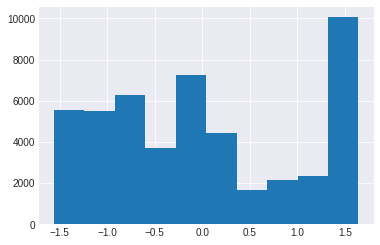

In [ ]:
plt.hist(x = df_airbnb['neighbourhood']);

In [ ]:
plot = px.histogram(df_airbnb, x = "neighbourhood")
plot.show()

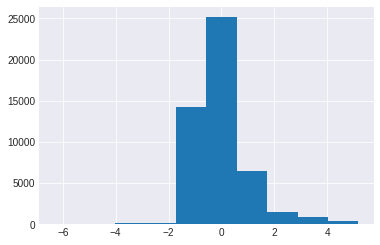

In [ ]:
plt.hist(x = df_airbnb['longitude']);

In [ ]:
plot = px.histogram(df_airbnb, x = "longitude")
plot.show()

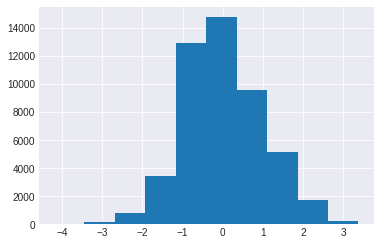

In [ ]:
plt.hist(x = df_airbnb['latitude']);

In [ ]:
plot = px.histogram(df_airbnb, x = "latitude")
plot.show()

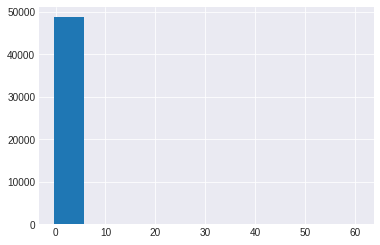

In [ ]:
plt.hist(x = df_airbnb['minimum_nights']);

In [ ]:
# esse grafico aqui é mais detalhado do que o hist acima ("mais aberto")

plot = px.histogram(df_airbnb, x = "minimum_nights")
plot.show()

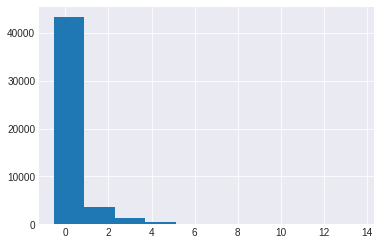

In [ ]:
plt.hist(x = df_airbnb['number_of_reviews']);

In [ ]:
plot = px.histogram(df_airbnb, x = 'number_of_reviews')
plot.show()

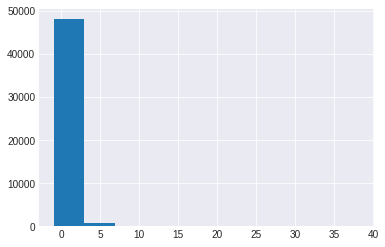

In [ ]:
plt.hist(x = df_airbnb['reviews_per_month']);

In [ ]:
plot = px.histogram(df_airbnb, x = 'reviews_per_month')
plot.show()

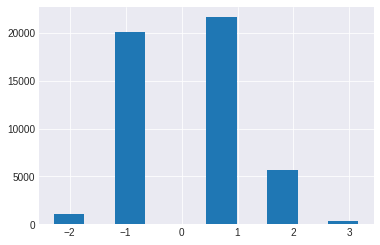

In [ ]:
plt.hist(x = df_airbnb['neighbourhood_group']);

In [ ]:
plot = px.histogram(df_airbnb, x = 'neighbourhood_group')
plot.show()

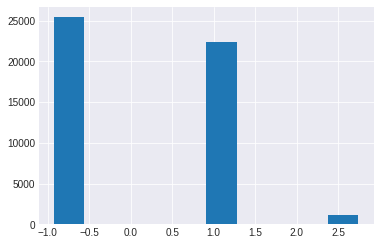

In [ ]:
plt.hist(x = df_airbnb['room_type']);

In [ ]:
plot = px.histogram(df_airbnb , x= 'room_type')
plot.show()

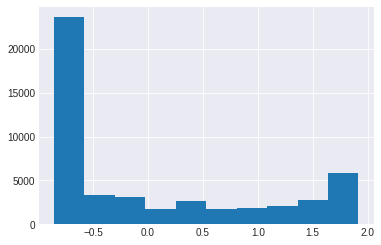

In [ ]:
plt.hist(x = df_airbnb['availability_365']);

In [ ]:
plot = px.histogram(df_airbnb , x= 'availability_365')
plot.show()


*texto em itálico*# --- 3 Bivariate analysis --- 

3. 

Perform a bi-variate analysis of the predictors. Specifically, you must plot the scatter
plots between all pairs of predictors. Investigate the existence of potential relationships
between pairs of predictors and the presence of potential outliers

previsores: neighbourhood_group,	room_type	minimum_nights,	number_of_reviews,	reviews_per_month,	availability_365

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['minimum_nights', 'number_of_reviews'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['minimum_nights', 'reviews_per_month'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['minimum_nights', 'neighbourhood_group'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['minimum_nights', 'room_type'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['minimum_nights', 'availability_365'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['number_of_reviews', 'reviews_per_month'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['number_of_reviews', 'neighbourhood_group'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['number_of_reviews', 'room_type'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['number_of_reviews', 'availability_365'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['neighbourhood_group', 'room_type'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['neighbourhood_group', 'reviews_per_month'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['neighbourhood_group', 'availability_365'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['room_type', 'reviews_per_month'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['room_type', 'availability_365'])
plot.show()

In [ ]:
plot = px.scatter_matrix(df_airbnb, dimensions= ['availability_365', 'reviews_per_month'])
plot.show()

**3.2**

Are there any relevant relationships between pairs of predictors? If yes, are these relationships
linear? Quantify linear dependence between predictors using pair-wise correlation
coefficients $\rho d_1, \rho d_j $ , with di; dj = 1,...,D. Either tabulate the correlation coefficients as a
correlation matrix, or show the matrix as an image. Comment on the results.


**R:** 

Sim, notamos que existem relações entre diversos preditores, como exemplo, entre numeros minimo de noites e numeros de reviews, numero de reviews e numero de reviews mês.



In [ ]:
df_airbnb

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,-0.917828,0.012762,-1.493849,-0.437652,0.909359,-0.293996,-0.320414,-7.766410e-01,-0.034716,1.916250
1,0.441222,0.289156,0.452436,-0.684639,-0.924247,-0.293996,0.487665,-6.631381e-01,-0.156104,1.840275
2,0.441222,-0.190897,1.468399,0.222497,0.909359,-0.196484,-0.522433,1.408386e-14,-0.186451,1.916250
3,-0.917828,-0.961892,-0.803398,-0.164450,-0.924247,-0.293996,5.538156,2.181110e+00,-0.186451,0.617065
4,0.441222,-0.670950,1.275660,0.177216,-0.924247,0.144807,-0.320414,-8.500840e-01,-0.186451,-0.856865
...,...,...,...,...,...,...,...,...,...,...
48890,-0.917828,-1.369209,-0.924616,0.048089,0.909359,-0.245240,-0.522433,1.408386e-14,-0.156104,-0.788486
48891,-0.917828,-1.151003,-0.497141,0.411637,0.909359,-0.147729,-0.522433,1.408386e-14,-0.156104,-0.583352
48892,0.441222,-0.190897,1.573480,0.075821,-0.924247,0.144807,-0.522433,1.408386e-14,-0.186451,-0.651730
48893,0.441222,-0.176350,0.523774,-0.843881,2.742965,-0.293996,-0.522433,1.408386e-14,-0.034716,-0.841669


In [ ]:
df_airbnb_with_price_log = df_airbnb
df_airbnb_with_price_log['price_log']= df['price_log']
df_airbnb_with_price_log

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price_log
0,-0.917828,0.012762,-1.493849,-0.437652,0.909359,-0.293996,-0.320414,-7.766410e-01,-0.034716,1.916250,5.010635
1,0.441222,0.289156,0.452436,-0.684639,-0.924247,-0.293996,0.487665,-6.631381e-01,-0.156104,1.840275,5.420535
2,0.441222,-0.190897,1.468399,0.222497,0.909359,-0.196484,-0.522433,1.408386e-14,-0.186451,1.916250,5.017280
3,-0.917828,-0.961892,-0.803398,-0.164450,-0.924247,-0.293996,5.538156,2.181110e+00,-0.186451,0.617065,4.499810
4,0.441222,-0.670950,1.275660,0.177216,-0.924247,0.144807,-0.320414,-8.500840e-01,-0.186451,-0.856865,4.394449
...,...,...,...,...,...,...,...,...,...,...,...
48890,-0.917828,-1.369209,-0.924616,0.048089,0.909359,-0.245240,-0.522433,1.408386e-14,-0.156104,-0.788486,4.262680
48891,-0.917828,-1.151003,-0.497141,0.411637,0.909359,-0.147729,-0.522433,1.408386e-14,-0.156104,-0.583352,3.713572
48892,0.441222,-0.190897,1.573480,0.075821,-0.924247,0.144807,-0.522433,1.408386e-14,-0.186451,-0.651730,4.753590
48893,0.441222,-0.176350,0.523774,-0.843881,2.742965,-0.293996,-0.522433,1.408386e-14,-0.034716,-0.841669,4.025352


Text(0.5, 1.0, 'Correlation Matrix')

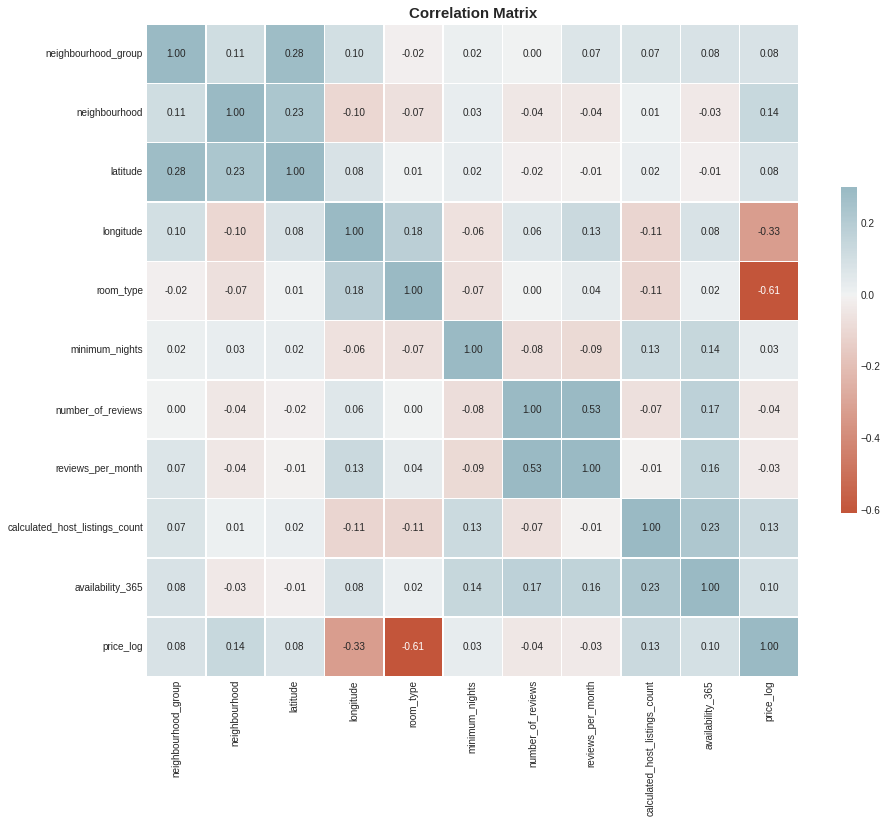

In [ ]:
plt.figure(figsize=(15,12))
palette = sns.diverging_palette(20, 220, n=256)
corr=df_airbnb_with_price_log.corr(method='pearson')
sns.heatmap(corr, annot=True, fmt=".2f", cmap=palette, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}).set(ylim=(11, 0))
plt.title("Correlation Matrix",size=15, weight='bold')

Vemos que existe uma relação moderada entre número de reviews por mês e número de reviews 0.3 $\leq$ |r| $<$0.7 e as outras relações são fracas 0.0 $\leq$ |r| $<$0.3

**4** 
Perform a multi-variate analysis of the predictors. Specifically, you must perform a
principal components analysis of the predictors, retain only the first two principal
components (those associated with the two largest eigenvalues) and plot the scatter plot of the projected observations

**PCA COM BIB**

In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(df_airbnb)
components = pca.fit_transform(df_airbnb)



In [ ]:
print("auto vetores:")
print(pca.components_)
print()

auto vetores:
[[ 0.03207908 -0.19906229 -0.05297068  0.36957154  0.30679695 -0.18717589
   0.52705014  0.54958847 -0.15519266  0.20415991 -0.21260662]
 [ 0.37663213  0.27298978  0.31336789 -0.11026808 -0.34807842  0.21365213
   0.24926928  0.27182544  0.37366414  0.3971603   0.27032403]]



In [ ]:
print("auto valores:")
print(pca.explained_variance_)
print()

auto valores:
[1.74048852 1.55728554]



In [ ]:
print(pca.explained_variance_ratio_)
print(pca.singular_values_)

[0.16601841 0.14854339]
[291.71809269 275.93825217]


Vemos que com 2 Principais Componentes não conseguimos alcançar uma bom valor de variance, assim, para reduzir a dimensão sem perder tanta precisão precisamos de mais componentes

Vamos agorar gerar o novo df com os dois principais componentes

In [ ]:
X = pca.transform(df_airbnb)
pca_airbnb = pd.DataFrame(X, columns = ['pc1', 'pc2'])
price= df[df['price_log'].notna()]
price.reset_index(drop=True, inplace=True)
df_pca = pca_airbnb
df_pca['price_log'] = price['price_log']
df_pca

,pc1,pc2,price_log
0,-0.037878,-0.610299,5.010635
1,-0.401763,1.519948,5.420535
2,0.457562,0.828132,5.017280
3,4.238205,1.501692,4.499810
4,-0.874292,-0.097621,4.394449
...,...,...,...
48890,0.323476,-2.013337,4.262680
48891,0.532125,-1.906032,3.713572
48892,-0.696855,0.497210,4.753590
48893,0.315683,-1.312177,4.025352


SCREE PLOT 

[0.16601841 0.14854339 0.13287199 0.11728255 0.08728014 0.0830068 ]


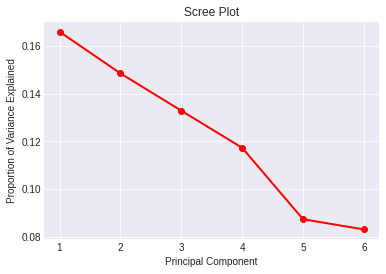

In [ ]:
pca = PCA(n_components=6)
pca.fit(df_airbnb)
PC_values = np.arange(pca.n_components_) + 1
print(pca.explained_variance_ratio_)
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

Scatter plot:

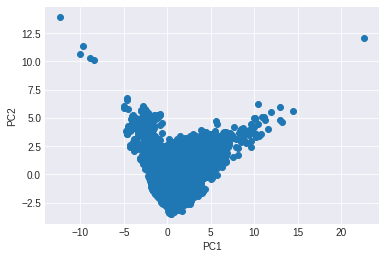

In [ ]:
plt.scatter(X[:,0], X[:,1])
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.show()

BIPLOT

In [ ]:
loadings = pca.components_.T * np.sqrt(pca.explained_variance_)
features = ['minimum_nights', 'number_of_reviews', 'reviews_per_month', 'availability_365', 'latitude','longitude','neighbourhood_group', 'room_type','neighbourhood']
fig = px.scatter(components, x=0, y=1)

for i, feature in enumerate(features):
    fig.add_shape(
        type='line',
        x0=0, y0=0,
        x1=loadings[i, 0],
        y1=loadings[i, 1]
    )
    fig.add_annotation(
        x=loadings[i, 0],
        y=loadings[i, 1],
        ax=0, ay=0,
        xanchor="center",
        yanchor="bottom",
        text=feature,
    )
  
fig.show()



**Question:**

Are the data well (or better) separated? What predictors show a high degree of overlapand thus are harder to separate?

Better separeted = desejamos tirar preditores que possuem correlações, dados melhor separados significa dados com pouca correlação, para ter o máximo de informação com a menor quantidade de dados

**R:**
Com execessão de reviews por mes e numero de reviews, os outros preditores estão bem separados.


[texto do link](https://)# --- Limpeza dos Dados ---